In [46]:
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os

import torch
import torch.nn as nn

from sklearn.preprocessing import MinMaxScaler

In [2]:
data_dir = '/Volumes/Seagate-Backup/financial-data/AS500-by-stock/19-20'
# file = 'AAPL.csv'

In [15]:
apple_raw= pd.read_csv(os.path.join(data_dir, 'AAPL.csv'))

In [16]:
apple_raw.head()

,Unnamed: 0,Date,Timestamp,Ticker,OpenPrice,HighPrice,LowPrice,ClosePrice,TotalVolume,TotalQuantity,TotalTradeCount
0,117545,20190102,09:31:00,AAPL,154.89,155.25,154.53,154.78,33646657.94,217411,1189
1,117546,20190102,09:32:00,AAPL,154.79,155.55,154.78,155.16,22625778.44,145750,624
2,117547,20190102,09:33:00,AAPL,155.18,155.30,154.77,154.81,21825180.18,140802,709
3,117548,20190102,09:34:00,AAPL,154.83,154.90,154.58,154.67,23962246.57,154889,803
4,117549,20190102,09:35:00,AAPL,154.63,155.00,154.62,154.75,20637571.95,133310,672


In [17]:


apple_raw.Date= apple_raw.Date.apply(lambda x: str(x))
apple_raw.Date= apple_raw.Date.apply(lambda x: x[:4] + '-' + x[4:6] + '-' + x[6:])
apple_raw.Date = apple_raw.Date + ' ' + apple_raw.Timestamp

apple_raw.drop(columns={'Unnamed: 0', 'Timestamp'}, inplace= True)

apple_raw.set_index('Date')

apple_raw.head()

,Date,Ticker,OpenPrice,HighPrice,LowPrice,ClosePrice,TotalVolume,TotalQuantity,TotalTradeCount
0,2019-01-02 09:31:00,AAPL,154.89,155.25,154.53,154.78,33646657.94,217411,1189
1,2019-01-02 09:32:00,AAPL,154.79,155.55,154.78,155.16,22625778.44,145750,624
2,2019-01-02 09:33:00,AAPL,155.18,155.30,154.77,154.81,21825180.18,140802,709
3,2019-01-02 09:34:00,AAPL,154.83,154.90,154.58,154.67,23962246.57,154889,803
4,2019-01-02 09:35:00,AAPL,154.63,155.00,154.62,154.75,20637571.95,133310,672


In [18]:
# make sure data is sorted
apple_sorted = apple_raw.sort_index(inplace=False, ascending=True, )

In [19]:
apple_sorted.head()

,Date,Ticker,OpenPrice,HighPrice,LowPrice,ClosePrice,TotalVolume,TotalQuantity,TotalTradeCount
0,2019-01-02 09:31:00,AAPL,154.89,155.25,154.53,154.78,33646657.94,217411,1189
1,2019-01-02 09:32:00,AAPL,154.79,155.55,154.78,155.16,22625778.44,145750,624
2,2019-01-02 09:33:00,AAPL,155.18,155.30,154.77,154.81,21825180.18,140802,709
3,2019-01-02 09:34:00,AAPL,154.83,154.90,154.58,154.67,23962246.57,154889,803
4,2019-01-02 09:35:00,AAPL,154.63,155.00,154.62,154.75,20637571.95,133310,672


In [20]:
# very simple model with just close price -- still use minute data
apple_sorted = apple_sorted[['ClosePrice']]

In [21]:
apple_sorted.head()

,ClosePrice
0,154.78
1,155.16
2,154.81
3,154.67
4,154.75


In [23]:
# normalize ClosePrice

scaler = MinMaxScaler(feature_range = [-1, 1])
apple_sorted['ClosePrice'] = scaler\
    .fit_transform(apple_sorted['ClosePrice'].values.reshape(-1,1))

In [24]:
apple_sorted.head()

,ClosePrice
0,-0.752276
1,-0.750426
2,-0.752130
3,-0.752811
4,-0.752422


In [25]:
apple_sorted.shape

(187402, 1)

In [27]:
# 80 20 split
def split_data(stock, lookback):
    data_raw = stock.to_numpy() # convert to numpy array
    data = []
    
    # create all possible sequences of length seq_len
    for index in range(len(data_raw) - lookback): 
        data.append(data_raw[index: index + lookback])
    
    data = np.array(data);
    test_set_size = int(np.round(0.2*data.shape[0]));
    train_set_size = data.shape[0] - (test_set_size);
    
    x_train = data[:train_set_size,:-1,:]
    y_train = data[:train_set_size,-1,:]
    
    x_test = data[train_set_size:,:-1]
    y_test = data[train_set_size:,-1,:]
    
    return [x_train, y_train, x_test, y_test]


In [31]:
lookback = 20 # choose sequence length
x_train, y_train, x_test, y_test = split_data(apple_sorted, lookback)

In [35]:
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((149906, 19, 1), (149906, 1), (37476, 19, 1), (37476, 1))

In [36]:
# convert to tensors
x_train = torch.from_numpy(x_train).type(torch.Tensor)
x_test = torch.from_numpy(x_test).type(torch.Tensor)
y_train_lstm = torch.from_numpy(y_train).type(torch.Tensor)
y_test_lstm = torch.from_numpy(y_test).type(torch.Tensor)
y_train_gru = torch.from_numpy(y_train).type(torch.Tensor)
y_test_gru = torch.from_numpy(y_test).type(torch.Tensor)

In [37]:
# define values for NN
input_dim = 1
hidden_dim = 32
num_layers = 2
output_dim = 1
num_epochs = 100

In [38]:
class LSTM(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_layers, output_dim):
        super(LSTM, self).__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_dim, output_dim)
    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).requires_grad_()
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).requires_grad_()
        out, (hn, cn) = self.lstm(x, (h0.detach(), c0.detach()))
        out = self.fc(out[:, -1, :]) 
        return out

In [39]:
model = LSTM(input_dim=input_dim, hidden_dim=hidden_dim, 
             output_dim=output_dim, num_layers=num_layers)
criterion = torch.nn.MSELoss(reduction='mean')
optimiser = torch.optim.Adam(model.parameters(), lr=0.01) # can increase lr later

In [41]:
hist = np.zeros(num_epochs)
start_time = time.time()
lstm = []
for t in range(num_epochs):
    y_train_pred = model(x_train)
    loss = criterion(y_train_pred, y_train_lstm)
    print("Epoch ", t, "MSE: ", loss.item())
    hist[t] = loss.item()
    optimiser.zero_grad()
    loss.backward()
    optimiser.step()
    
training_time = time.time()-start_time
print("Training time: {}".format(training_time))

Epoch  0 MSE:  0.40843942761421204
Epoch  1 MSE:  0.26066136360168457
Epoch  2 MSE:  0.15136192739009857
Epoch  3 MSE:  0.07360191643238068
Epoch  4 MSE:  0.16716687381267548
Epoch  5 MSE:  0.0954560860991478
Epoch  6 MSE:  0.06602584570646286
Epoch  7 MSE:  0.07394122332334518
Epoch  8 MSE:  0.08465554565191269
Epoch  9 MSE:  0.08883029967546463
Epoch  10 MSE:  0.08653087168931961
Epoch  11 MSE:  0.07980620861053467
Epoch  12 MSE:  0.07090746611356735
Epoch  13 MSE:  0.06202579662203789
Epoch  14 MSE:  0.055216751992702484
Epoch  15 MSE:  0.05194004625082016
Epoch  16 MSE:  0.051974453032016754
Epoch  17 MSE:  0.052564602345228195
Epoch  18 MSE:  0.04976499080657959
Epoch  19 MSE:  0.04168891906738281
Epoch  20 MSE:  0.030235903337597847
Epoch  21 MSE:  0.01940598525106907
Epoch  22 MSE:  0.012295978143811226
Epoch  23 MSE:  0.00890282541513443
Epoch  24 MSE:  0.006788988132029772
Epoch  25 MSE:  0.0077038235031068325
Epoch  26 MSE:  0.01464132685214281
Epoch  27 MSE:  0.0150324180722

In [42]:
predict = pd.DataFrame(scaler.inverse_transform(y_train_pred.detach().numpy()))
original = pd.DataFrame(scaler.inverse_transform(y_train_lstm.detach().numpy()))

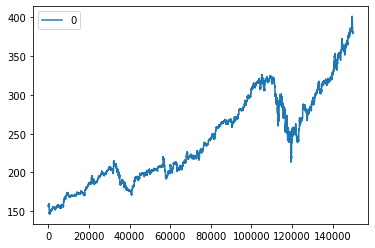

In [43]:
predict.plot()

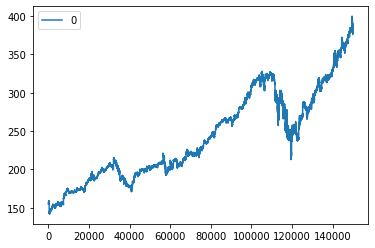

In [44]:
original.plot()

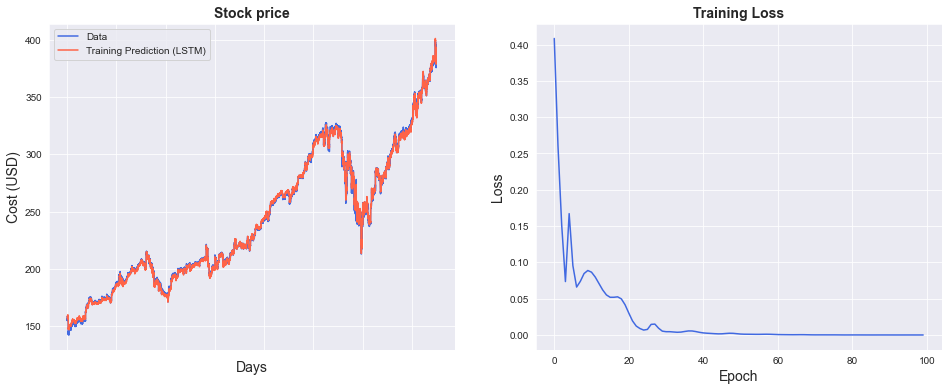

In [47]:
import seaborn as sns
sns.set_style("darkgrid")    

fig = plt.figure()
fig.subplots_adjust(hspace=0.2, wspace=0.2)

plt.subplot(1, 2, 1)
ax = sns.lineplot(x = original.index, y = original[0], label="Data", color='royalblue')
ax = sns.lineplot(x = predict.index, y = predict[0], label="Training Prediction (LSTM)", color='tomato')
ax.set_title('Stock price', size = 14, fontweight='bold')
ax.set_xlabel("Days", size = 14)
ax.set_ylabel("Cost (USD)", size = 14)
ax.set_xticklabels('', size=10)


plt.subplot(1, 2, 2)
ax = sns.lineplot(data=hist, color='royalblue')
ax.set_xlabel("Epoch", size = 14)
ax.set_ylabel("Loss", size = 14)
ax.set_title("Training Loss", size = 14, fontweight='bold')
fig.set_figheight(6)
fig.set_figwidth(16)

In [48]:
import math, time
from sklearn.metrics import mean_squared_error

# make predictions
y_test_pred = model(x_test)

# invert predictions
y_train_pred = scaler.inverse_transform(y_train_pred.detach().numpy())
y_train = scaler.inverse_transform(y_train_lstm.detach().numpy())
y_test_pred = scaler.inverse_transform(y_test_pred.detach().numpy())
y_test = scaler.inverse_transform(y_test_lstm.detach().numpy())

# calculate root mean squared error
trainScore = math.sqrt(mean_squared_error(y_train[:,0], y_train_pred[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = math.sqrt(mean_squared_error(y_test[:,0], y_test_pred[:,0]))
print('Test Score: %.2f RMSE' % (testScore))
lstm.append(trainScore)
lstm.append(testScore)
lstm.append(training_time)

Train Score: 1.23 RMSE
Test Score: 18.38 RMSE


In [52]:
# shift train predictions for plotting
trainPredictPlot = np.empty_like(apple_sorted)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[lookback:len(y_train_pred)+lookback, :] = y_train_pred

# shift test predictions for plotting
testPredictPlot = np.empty_like(apple_sorted)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(y_train_pred)+lookback-1:len(apple_sorted)-1, :] = y_test_pred

original = scaler.inverse_transform(apple_sorted['ClosePrice'].values.reshape(-1,1))

predictions = np.append(trainPredictPlot, testPredictPlot, axis=1)
predictions = np.append(predictions, original, axis=1)
result = pd.DataFrame(predictions)

In [54]:
import plotly.express as px
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Scatter(go.Scatter(x=result.index, y=result[0],
                    mode='lines',
                    name='Train prediction')))
fig.add_trace(go.Scatter(x=result.index, y=result[1],
                    mode='lines',
                    name='Test prediction'))
fig.add_trace(go.Scatter(go.Scatter(x=result.index, y=result[2],
                    mode='lines',
                    name='Actual Value')))
fig.update_layout(
    xaxis=dict(
        showline=True,
        showgrid=True,
        showticklabels=False,
        linecolor='white',
        linewidth=2
    ),
    yaxis=dict(
        title_text='Close (USD)',
        titlefont=dict(
            family='Rockwell',
            size=12,
            color='white',
        ),
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='white',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Rockwell',
            size=12,
            color='white',
        ),
    ),
    showlegend=True,
    template = 'plotly_dark'

)



annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Results (LSTM)',
                              font=dict(family='Rockwell',
                                        size=26,
                                        color='white'),
                              showarrow=False))
fig.update_layout(annotations=annotations)

fig.show()

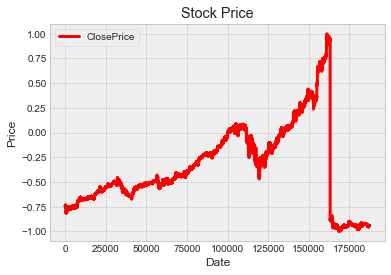

In [58]:
plt.style.use('bmh')
ax = apple_sorted.plot(color='red', grid=True, linewidth=3, fontsize=10)
ax.set_xlabel('Date')
ax.set_ylabel('Price')
ax.set_title('Stock Price')
plt.show()